In [70]:
import os
import numpy as np
from PIL import Image
import torch
from torchvision import models, transforms
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from collections import Counter, defaultdict
import matplotlib.pyplot as plt
import shutil
import random
import pandas as pd

# Klateryzacja danych w celu sprawdzenia redundancji

Dobre wyniki modelu klasyfikującego wydają się być skutkiem trenowania na zbliżonych zdjęciach i również testowania. Model wydaje się, że jest nauczony na pamięć i stąd jego dobra skuteczność 98%.

In [71]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])
resnet = models.resnet50(pretrained=True)
feature_extractor = torch.nn.Sequential(*list(resnet.children())[:-1])

c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [72]:
def extract_features(folder):
    features = []
    filenames = []
    for f in os.listdir(folder):
        if f.lower().endswith((".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff")):
            path = os.path.join(folder, f)
            try:
                img = Image.open(path).convert('RGB')
                img_tensor = transform(img).unsqueeze(0)
                with torch.no_grad():
                    feat = feature_extractor(img_tensor).squeeze().numpy()
                features.append(feat.flatten())
                filenames.append(f)
            except Exception as e:
                print(f"Błąd przy {path}:", e)
    return np.array(features), filenames


In [73]:
def perform_clustering(folder_name):
    folder = f"output/{folder_name}"
    feature_extractor.eval()
    
    features, filenames = extract_features(folder)

    if features.shape[0] == 0:
        print("Brak danych")
    else:
        print("Redukcja wymiarów")
        features_pca = PCA(n_components=50).fit_transform(features)
        
    print("Klasteryzacja")
    clustering = DBSCAN(eps=6.5, min_samples=2).fit(features_pca) # w drugiej wersji eps = 7, 5
    labels = clustering.labels_

    label_counts = Counter(labels)

    n_total = len(labels)
    n_unique = label_counts[-1] if -1 in label_counts else 0
    n_clustered = n_total - n_unique
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

    print("\n Podsumowanie:")
    print(f"Całkowita liczba zdjęć: {n_total}")
    print(f"Liczba zdjęć w klastrach: {n_clustered}")
    print(f"Liczba zdjęć unikalnych (outliery): {n_unique}")
    print(f"Liczba wykrytych klastrów: {n_clusters}")
    
    sorted_clusters = [(cid, cnt) for cid, cnt in label_counts.items() if cid != -1]
    sorted_clusters.sort(key=lambda x: x[1], reverse=True)
    sorted_cluster_ids = np.array([cid for cid, _ in sorted_clusters])

    return features, labels, filenames, n_total, n_clustered, n_unique, n_clusters, sorted_cluster_ids

Funkcja pokazująca zdjęcia z danego klastra. Za pomocą zwracanej tablicy array z funckcji 'perform_clustering' można zobaczyć numery klastrów uporządkowane malejącą liczbą zdjęć.

In [119]:
def show_cluster_images(cluster_label, labels, folder_name, filenames, num_per_row=5):
    folder = f"output/{folder_name}"
    indices = [i for i, label in enumerate(labels) if label == cluster_label]
    quantity = len(indices)
    if quantity > 100:
        indices = random.sample(indices, 100)
    if not indices:
        print(f"Brak zdjęć w klastrze {cluster_label}")
        return
    
    print(f"Klastrowi {cluster_label} przypisano {quantity} zdjęć")
    
    n = len(indices)
    rows = (n + num_per_row - 1) // num_per_row
        
    
    fig, axs = plt.subplots(rows, num_per_row, figsize=(15, 3 * rows))
    axs = axs.flatten()

    for ax in axs[n:]:
        ax.axis('off') 

    for i, idx in enumerate(indices):
        img_path = os.path.join(folder, filenames[idx])
        img = Image.open(img_path)
        axs[i].imshow(img)
        axs[i].set_title(filenames[idx], fontsize=8)
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()


Funkcja wyświetlająca 10 losowych unikalnych zdjęć. Można sprawdzić czy rzeczywiście zdjęcia są różne.

In [75]:
def show_outliers(labels, folder_name, filenames, num_images_to_show=10):
    cluster_label=-1
    folder = f"output/{folder_name}"

    indices = [i for i, label in enumerate(labels) if label == cluster_label]
    
    if not indices:
        print(f"Brak zdjęć w klastrze {cluster_label}")
        return
    
    print(f"Klastrowi {cluster_label} przypisano {len(indices)} zdjęć")

    indices = random.sample(indices, min(num_images_to_show, len(indices)))
    n = len(indices)
    rows = (n + 4) // 5 
    
    fig, axs = plt.subplots(rows, 5, figsize=(15, 3 * rows))
    axs = axs.flatten()

    for ax in axs[n:]:
        ax.axis('off')
    
    for i, idx in enumerate(indices):
        img_path = os.path.join(folder, filenames[idx])
        img = Image.open(img_path)
        axs[i].imshow(img)
        axs[i].set_title(filenames[idx], fontsize=8)
        axs[i].axis('off')  
    
    plt.tight_layout()
    plt.show()

Funckja zapisująca potencjalnie zbiór bardziej unikalnych zdjęć czyli wszystkie outliery plus losowe zdjęcie z każdego klastra.

In [76]:
def save_cluster_images(features, labels, filenames, folder_name, output_folder="output_samples"):
    if features is None:
        print("Brak danych do zapisania")
        return
    
    cluster_to_files = defaultdict(list)
    for label, filename in zip(labels, filenames):
        cluster_to_files[label].append(filename)

    os.makedirs(output_folder, exist_ok=True)

    for cluster_id, files in cluster_to_files.items():
        selected_files = files if cluster_id == -1 else [random.choice(files)] 

        for f in selected_files:
            label_name = f.split("_")[0] 

            src_path = os.path.join(f"output/{folder_name}", f)
            dst_dir = os.path.join(output_folder, label_name)
            os.makedirs(dst_dir, exist_ok=True)
            dst_path =  dst_path = os.path.join(dst_dir, f) 
            
            try:
                shutil.copyfile(src_path, dst_path)
                #print(f"Zapisano: {f} (klaster {cluster_id}) → {dst_path}")
            except FileNotFoundError:
                print(f"Nie znaleziono pliku: {src_path}")

In [77]:
def show_one_image_per_cluster(labels, folder_name, filenames, num_per_row=5):
    cluster_to_files = defaultdict(list)

    for label, filename in zip(labels, filenames):
        cluster_to_files[label].append(filename)

    selected_items = [(cluster_id, random.choice(files)) for cluster_id, files in cluster_to_files.items()]

    n = len(selected_items)
    rows = (n + num_per_row - 1) // num_per_row
    fig, axs = plt.subplots(rows, num_per_row, figsize=(15, 3 * rows))
    axs = axs.flatten()

    for ax in axs[n:]:
        ax.axis('off')

    for i, (cluster_id, filename) in enumerate(selected_items):
        img_path = os.path.join(f"output/{folder_name}", filename)
        img = Image.open(img_path)
        axs[i].imshow(img)
        axs[i].set_title(f"Klaster {cluster_id}", fontsize=8)
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()


In [78]:
features_AVM, labels_AVM, filenames_AVM, n_total_AVM, n_clustered_AVM, n_unique_AVM, n_clusters_AVM, sorted_clusters_AVM = perform_clustering("AVM")

Redukcja wymiarów
Klasteryzacja

 Podsumowanie:
Całkowita liczba zdjęć: 668
Liczba zdjęć w klastrach: 560
Liczba zdjęć unikalnych (outliery): 108
Liczba wykrytych klastrów: 65


In [79]:
sorted_clusters_AVM[0:5]

array([25, 59, 43, 29,  1])

Klastrowi 25 przypisano 64 zdjęć


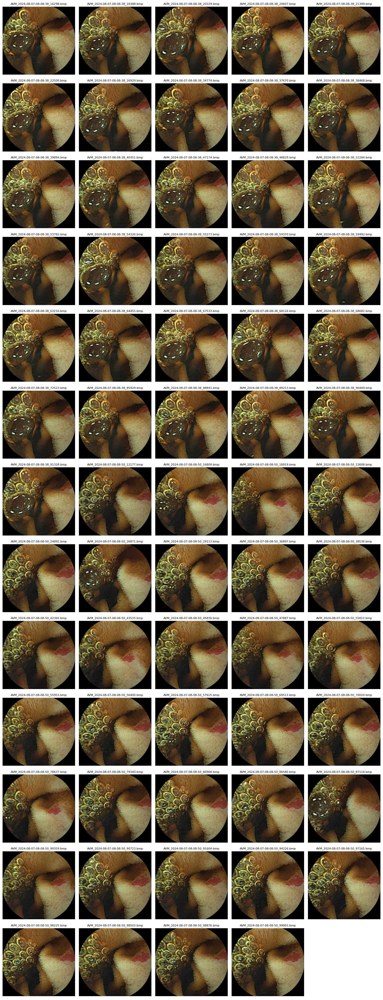

In [80]:
show_cluster_images(25, labels_AVM, "AVM", filenames_AVM)

Klastrowi 59 przypisano 43 zdjęć


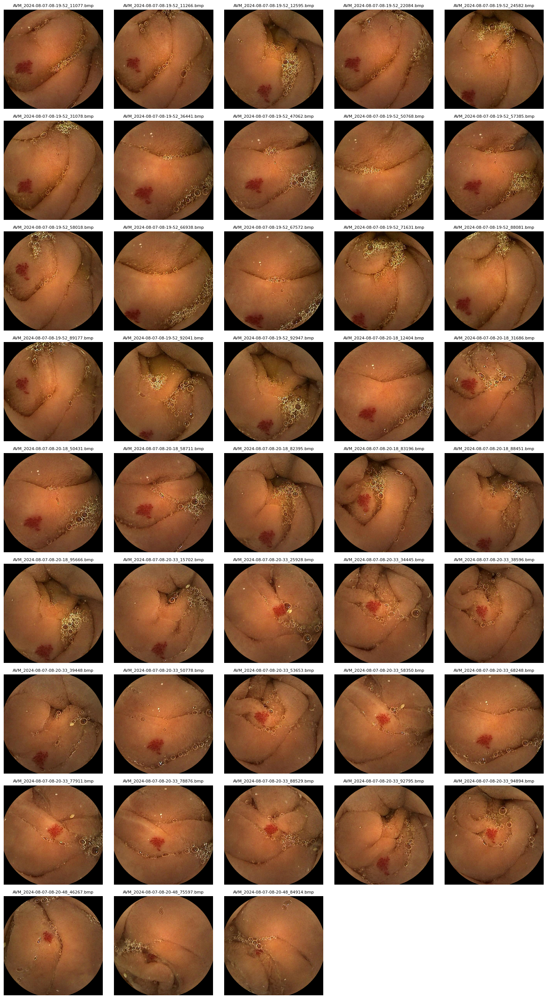

In [81]:
show_cluster_images(59, labels_AVM, "AVM", filenames_AVM)

Klastrowi 43 przypisano 33 zdjęć


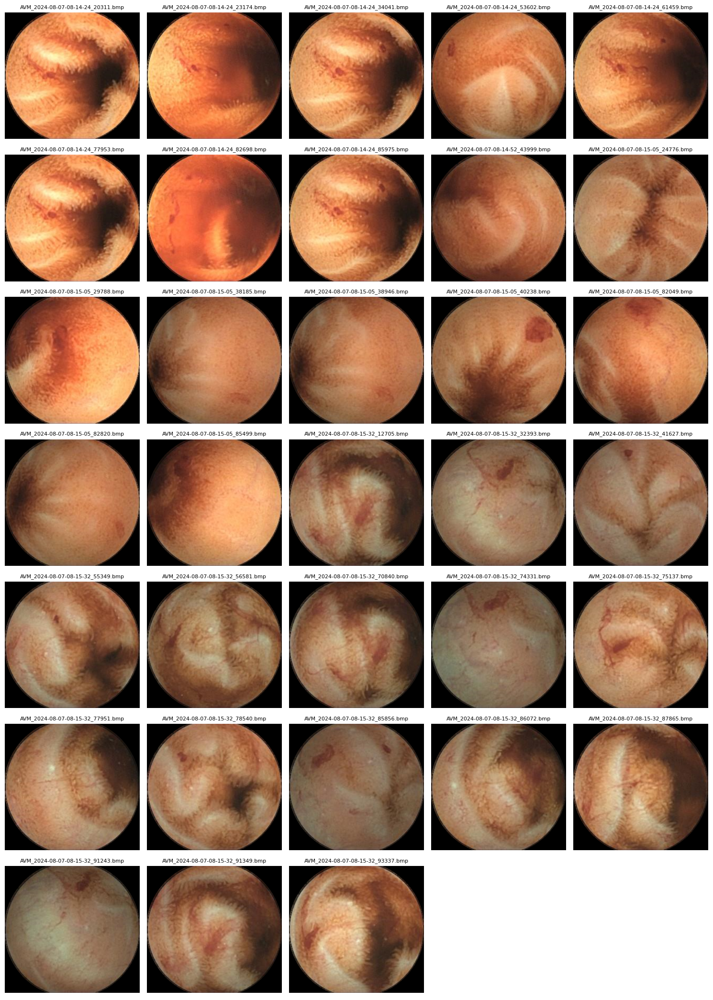

In [82]:
show_cluster_images(43, labels_AVM, "AVM", filenames_AVM)

Klastrowi -1 przypisano 108 zdjęć


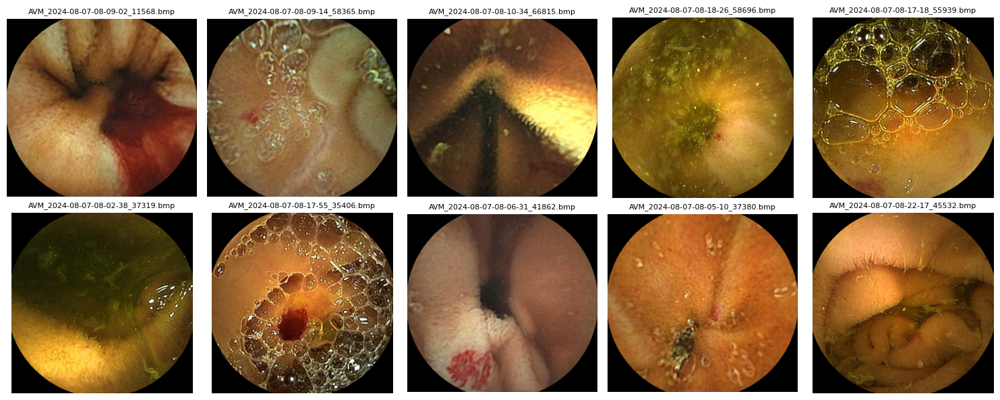

In [83]:
show_outliers(labels_AVM, "AVM", filenames_AVM, num_images_to_show=10)

In [84]:
features_Ulcer, labels_Ulcer, filenames_Ulcer, n_total_Ulcer, n_clustered_Ulcer, n_unique_Ulcer, n_clusters_Ulcer, sorted_clusters_Ulcer = perform_clustering("Ulcer")

Redukcja wymiarów
Klasteryzacja

 Podsumowanie:
Całkowita liczba zdjęć: 465
Liczba zdjęć w klastrach: 363
Liczba zdjęć unikalnych (outliery): 102
Liczba wykrytych klastrów: 35


In [85]:
sorted_clusters_Ulcer[0:5]

array([ 0, 10,  1, 28, 19])

Dla klastra 0  trochę dużo zdjęć i nie są one aż tak bardzo podobne.

Klastrowi 10 przypisano 13 zdjęć


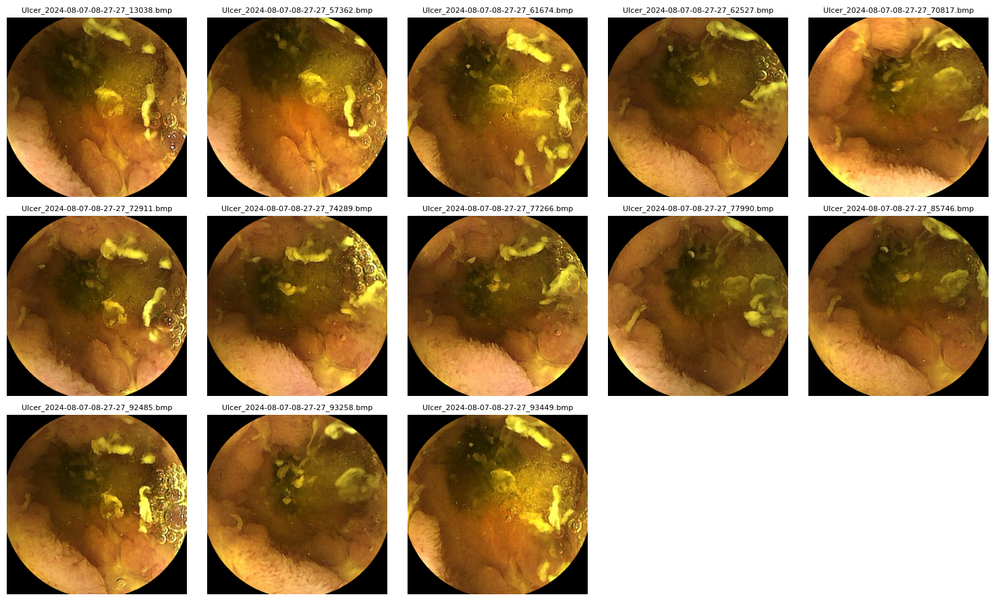

In [87]:
show_cluster_images(10, labels_Ulcer, "Ulcer", filenames_Ulcer)

Klastrowi -1 przypisano 102 zdjęć


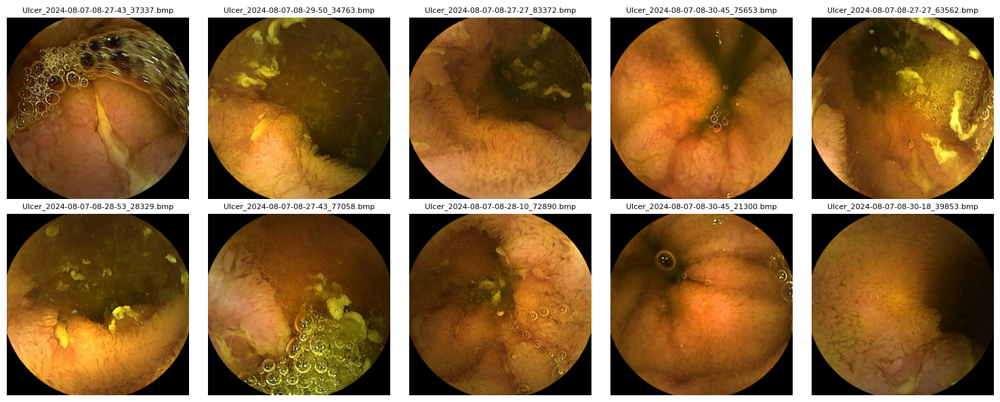

In [89]:
show_outliers(labels_Ulcer, "Ulcer", filenames_Ulcer, num_images_to_show=10)

In [88]:
features_Normal, labels_Normal, filenames_Normal, n_total_Normal, n_clustered_Normal, n_unique_Normal, n_clusters_Normal, sorted_clusters_Normal = perform_clustering("Normal")

Redukcja wymiarów
Klasteryzacja

 Podsumowanie:
Całkowita liczba zdjęć: 2152
Liczba zdjęć w klastrach: 1691
Liczba zdjęć unikalnych (outliery): 461
Liczba wykrytych klastrów: 119


In [94]:
sorted_clusters_Normal[0:5]

array([ 6,  4, 59, 82, 90])

Klastrowi 4 przypisano 27 zdjęć


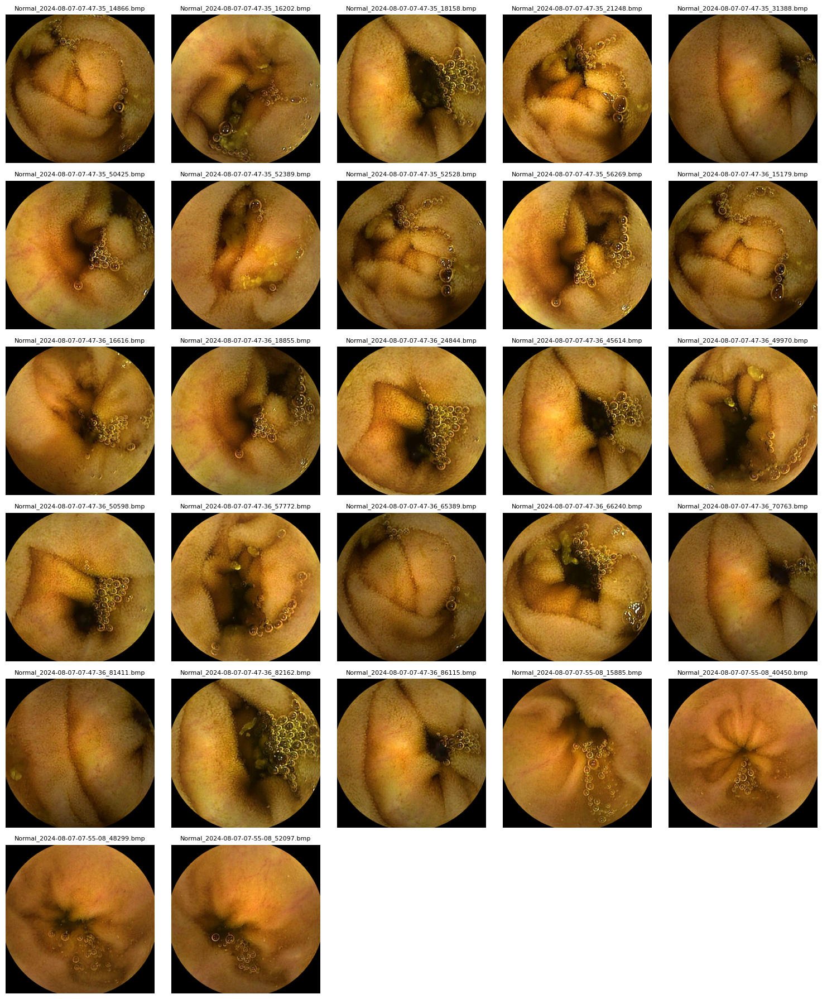

In [138]:
show_cluster_images(4, labels_Normal, "Normal", filenames_Normal)

Klastrowi 59 przypisano 14 zdjęć


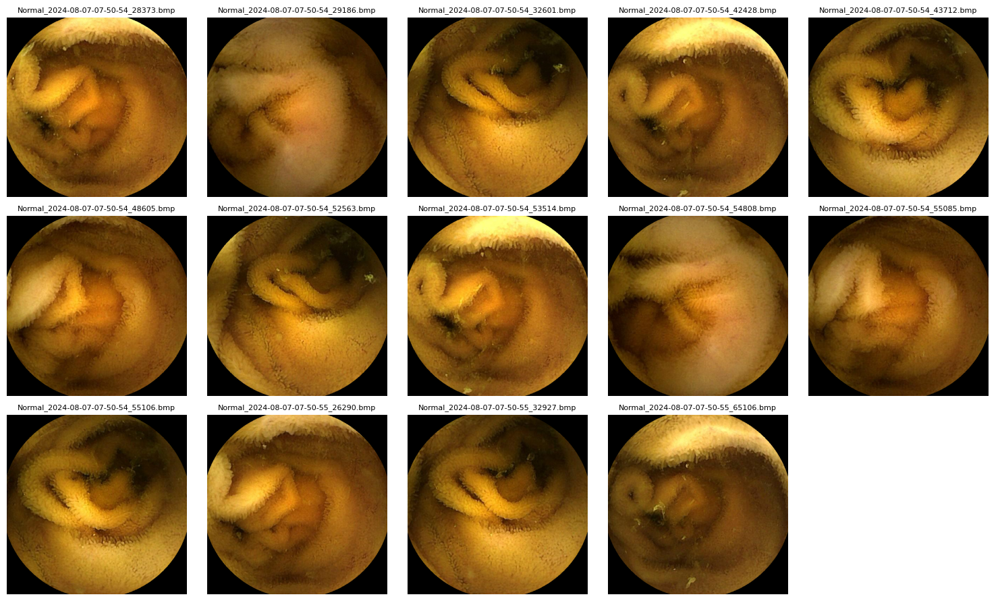

In [99]:
show_cluster_images(59, labels_Normal, "Normal", filenames_Normal)

Zdjęcia szczególnie klas AVM i Ulcer w przypisanych klasach wydają się być bardzo identyczne stąd zasadniczym wydaje się pozbycie się duplikatów nawet jeśli ma to zmniejszyć zbiór danych (pomimo i tak małych rozmiarów). 
Jednak utrata tych danych nie powoduje, że zdjęcia będą unikalne(nadal w outlierach i pomiędzy klastrami są podobne zdjęcia, ale sprawdzimy czy ten kierunek zmian rozwiąże ten problem w jakimś stopniu). (Potencjalnie jeśli będzie poprawa a zdjęć będzie za mało można przeprowadzić klasteryzację na największym klastrze który może być sporych rozmiarów dla Normal 1269 zdjęć które nie są takie same).

Klastrowi -1 przypisano 461 zdjęć


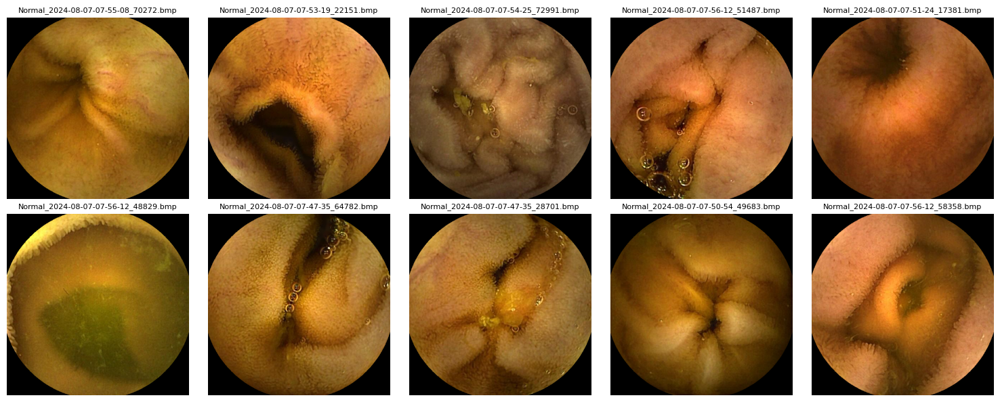

In [142]:
show_outliers(labels_Normal, "Normal", filenames_Normal)

Zbiór outlierów (unikalnych zdjęć) sprawia wrażenie nawet różnorodnego.

### Zapis potencjalnie unikalnych zdjęć do folderu output_samples
Zapis w celu sprawdzenia jak model wytrenowany na tych danych będzie sobie radził.

- **`output_samples`**  
  - Zbiór utworzony po klasteryzacji z parametrem **eps = 5**.  
  - Pozostało w nim **zbyt dużo duplikatów**.  
  - Uczenie modelu na tym zbiorze dało **bardzo wysokie wyniki**, analogiczne do wyników **przed usunięciem części zdjęć**. (inny plik)

- **`output_samples2`**  
  - Zbiór utworzony po klasteryzacji z parametrem **eps = 6.5**.  
  - Usunięto większą liczbę **zduplikowanych i bardzo podobnych zdjęć**.  

In [132]:
save_cluster_images(features_Normal, labels_Normal, filenames_Normal, "Normal", "output_samples2")

In [133]:
save_cluster_images(features_AVM, labels_AVM, filenames_AVM, "AVM", "output_samples2")

In [135]:
save_cluster_images(features_Ulcer, labels_Ulcer, filenames_Ulcer, "Ulcer", "output_samples2")

In [5]:
parent_folder = "output"
output_data = []  

for folder in os.listdir(parent_folder):
    folder_path = os.path.join(parent_folder, folder)
    if os.path.isdir(folder_path):
        count = sum(1 for f in os.listdir(folder_path) if f.endswith(".bmp"))
        output_data.append([folder, count])  
df_output = pd.DataFrame(output_data, columns=["Nazwa klasy", "Liczba zdjęć"])
df_output

,Nazwa klasy,Liczba zdjęć
0,AVM,668
1,Normal,2152
2,Ulcer,465


In [143]:
parent_folder = "output_samples"
output_data = []  

for folder in os.listdir(parent_folder):
    folder_path = os.path.join(parent_folder, folder)
    if os.path.isdir(folder_path):
        count = sum(1 for f in os.listdir(folder_path) if f.endswith(".bmp"))
        output_data.append([folder, count])  
df_output = pd.DataFrame(output_data, columns=["Nazwa klasy", "Liczba zdjęć"])
df_output

,Nazwa klasy,Liczba zdjęć
0,AVM,390
1,Normal,1606
2,Ulcer,362


In [136]:
parent_folder = "output_samples2"
output_data = []  

for folder in os.listdir(parent_folder):
    folder_path = os.path.join(parent_folder, folder)
    if os.path.isdir(folder_path):
        count = sum(1 for f in os.listdir(folder_path) if f.endswith(".bmp"))
        output_data.append([folder, count])  
df_output = pd.DataFrame(output_data, columns=["Nazwa klasy", "Liczba zdjęć"])
df_output

,Nazwa klasy,Liczba zdjęć
0,AVM,173
1,Normal,580
2,Ulcer,137


Spora część zdjęć została usunięta. Ale nadal nie są to tak unikalne zbiory zdjęć.